# Solar Dataset Analysis

In [3]:
# Import Required Libraries
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam
import statsmodels.api as sm
from sklearn.feature_selection import RFE
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from mlxtend.feature_selection import SequentialFeatureSelector
import plotly.express as px
import plotly.graph_objects as go
from xgboost import XGBRegressor

## Load and Prepare Data

In [59]:
def meansforstations(stations, df_merged):
    # Calculate the mean for the first 5113 rows
    for station in stations:
        df_merged[f'{station}_avg_per_monthday'] = df_merged['MonthDay'].map(df_merged.loc[:5112].groupby('MonthDay')[station].mean())
    return df_merged

def load_and_merge_datasets(solar_data_path, additional_data_path, preds):
    # Load datasets
    df_solar = pd.read_csv(solar_data_path)
    df_additional = pd.read_csv(additional_data_path)

    # Select columns that start with 'PC' and add 'ACME' and 'Date'
    pc_columns = [col for col in df_solar.columns if col.startswith("PC")]
    # pc_columns.extend(["ACME", "Date", "NINN", "CHIC", "APAC", "KETC"])
    pc_columns.extend(["ACME", "Date", "NINN", "CHIC", "APAC", "KETC"])

    # Create DataFrame with selected columns and merge
    df_pc = df_solar[pc_columns]
    
    df_merged = pd.merge(df_pc, df_additional, on="Date")
    
    # Convert date format
    df_merged["Date"] = pd.to_datetime(df_merged["Date"], format='%Y%m%d')
    
    
    # Replace the NaNs in the ytest part
    # Extract 'month' and 'day' from 'Date'
    df_merged['Month'] = df_merged['Date'].dt.month
    df_merged['Day'] = df_merged['Date'].dt.day

    # List of columns where you want to replace NaN with the monthly average
    columns_to_update = ['ACME', 'APAC', 'CHIC', 'KETC', 'NINN']

    # Calculate the mean of the same month/day combination for each column
    mean_by_month_day = df_merged.groupby(['Month', 'Day'])[columns_to_update].transform('mean')

    # Replace NaN values in df_merged with the calculated monthly averages
    df_merged[columns_to_update] = df_merged[columns_to_update].fillna(mean_by_month_day)

    # Drop 'Month' and 'Day' helper columns (if not needed)
    df_merged.drop(['Month', 'Day'], axis=1, inplace=True)
    
    # Extract month and day, and create a MonthDay column (ignoring the year)
    df_merged['MonthDay'] = df_merged['Date'].dt.strftime('%m-%d')

    df_merged = meansforstations(['ACME', 'APAC', 'CHIC', 'KETC', 'NINN'], df_merged)
    # Hardcoded distances to ACME for each station (from the image)
    distances_to_acme = {
        "NINN": 0.17460028923229295,
        "CHIC": 0.24904759585267908,
        "APAC": 0.2889927518122142,
        "KETC": 0.38062267365463004
    }

    # Calculate weights as inverse of distances
    weights = {station: 1/distance for station, distance in distances_to_acme.items()}

    # Normalize the weights so they sum to 1
    total_weight = sum(weights.values())
    weights = {station: weight/total_weight for station, weight in weights.items()}

    # Compute the weighted average of predictions for ACME
    df_merged['ACME_weighted_avg'] = sum(df_merged[f"{station}_avg_per_monthday"] * weight for station, weight in weights.items())

    # one hot encoding for months
    df_merged['month'] = df_merged["Date"].dt.month
    month_dummies = pd.get_dummies(df_merged['month'], prefix='month', drop_first=True)
    # Convert the dummy variables to integer type
    month_dummies = month_dummies.astype(int)
    df_merged = pd.concat([df_merged, month_dummies], axis=1)
    df_merged.drop(["Date", 'month', "MonthDay"], axis=1, inplace=True)
    
    """
    if preds:
        df_clean = df_merged[df_merged['ACME'].isna()]
    else:
        # Drop rows with NaN in 'ACME'. it messes up the prediction models
        df_clean = df_merged.dropna(subset=['ACME'])
    """
    # Handle missing values in the independent variables by filling with 0s
    df_clean = df_merged  # temp to delete
    df_clean.fillna(0, inplace=True)

    return df_clean

# Load the datasets
df_merged = load_and_merge_datasets("solar_dataset.csv", "additional_variables.csv", False)


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,-285.202347,6.018285,-24.174976,21.877974,-77.395214,-2.444447,20.420413,-13.911910,12.134023,-1.010264,...,0,0,0,0,0,0,0,0,0,0
1,-277.450331,-37.283934,-68.825274,-36.616387,-47.573043,-44.955798,-52.979626,20.761250,-10.488179,12.645553,...,0,0,0,0,0,0,0,0,0,0
2,-343.566915,10.337714,-45.909605,-2.348911,-31.865502,-11.210175,-3.006734,-43.453307,-15.251692,-3.478379,...,0,0,0,0,0,0,0,0,0,0
3,-350.773954,63.881444,19.030743,2.409239,-41.082846,-28.036183,-8.568985,-5.516248,-2.308654,-3.531262,...,0,0,0,0,0,0,0,0,0,0
4,-267.520943,12.524504,-76.004440,-108.891738,-16.768727,37.367270,-60.555546,-66.066619,-30.201076,8.154473,...,0,0,0,0,0,0,0,0,0,0


66
63


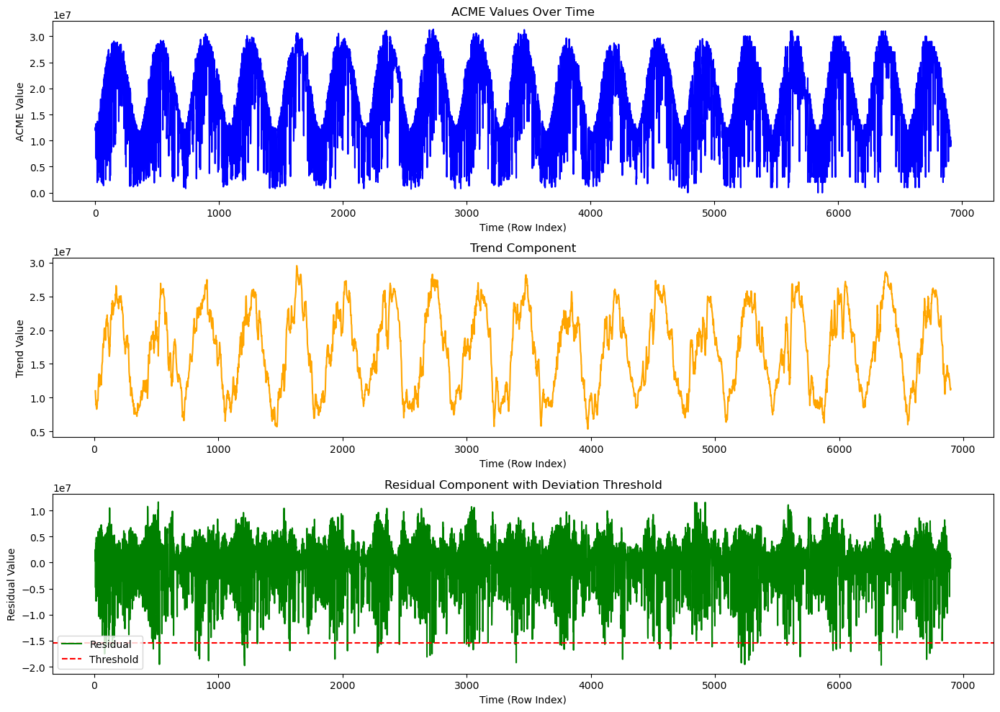

Correlation of variables with ACME during deviations:
ACME                     1.000000
PC1                      0.632992
month_6                  0.529652
KETC_avg_per_monthday    0.506008
PC2                      0.500187
V1354                    0.492345
V634                     0.468303
ACME_weighted_avg        0.462620
ACME_avg_per_monthday    0.462619
APAC_avg_per_monthday    0.454549
CHIC_avg_per_monthday    0.450999
V2794                    0.442282
NINN_avg_per_monthday    0.441284
V5674                    0.438259
V7834                    0.429497
V3514                    0.426145
V2074                    0.418146
V4234                    0.394700
V1370                    0.392889
V1785                    0.390980
V6394                    0.387358
V7130                    0.376751
V345                     0.376530
month_4                  0.367901
V6825                    0.352682
PC10                     0.351518
V361                     0.345615
PC217                    0.3

In [121]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Load your data
df = df_merged  # Replace with your actual data path

# Step 1: Decompose the time series
result = seasonal_decompose(df['ACME'], model='additive', period=19)  # Adjust period based on your data's seasonality
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# Step 2: Identify deviation points based on the residuals
residual_mean = np.nanmean(residual)  # Mean of residuals
residual_std = np.nanstd(residual)  # Standard deviation of residuals

# Identify deviations
threshold = residual_mean - 3 * residual_std  # Define a threshold for deviations
deviation_indices = np.where(residual < threshold)[0]
print(len(deviation_indices))
threshold2 = residual_mean + 1.75 * residual_std  # Define a threshold for deviations
deviation_indices2 = np.where(residual > threshold2)[0]
print(len(deviation_indices2))
deviations = df.iloc[np.concatenate([deviation_indices, deviation_indices2])]

# Step 3: Correlation analysis with other variables
# Get the subset of the DataFrame corresponding to the deviation indices
deviation_data = df.iloc[deviation_indices]

# Calculate correlation for deviation data
correlation = deviation_data.corr()  # Compute correlation matrix
deviation_correlation = correlation['ACME'].drop(['APAC', 'CHIC', 'KETC', 'NINN']).abs().sort_values(ascending=False)  # Correlation of other variables with ACME

# Step 4: Visual analysis
plt.figure(figsize=(14, 10))
plt.subplot(3, 1, 1)
plt.plot(df['ACME'], label='ACME', color='blue')
plt.title('ACME Values Over Time')
plt.xlabel('Time (Row Index)')
plt.ylabel('ACME Value')

plt.subplot(3, 1, 2)
plt.plot(trend, label='Trend', color='orange')
plt.title('Trend Component')
plt.xlabel('Time (Row Index)')
plt.ylabel('Trend Value')

plt.subplot(3, 1, 3)
plt.plot(residual, label='Residual', color='green')
plt.axhline(threshold, color='red', linestyle='--', label='Threshold')
plt.title('Residual Component with Deviation Threshold')
plt.xlabel('Time (Row Index)')
plt.ylabel('Residual Value')
plt.legend()

plt.tight_layout()
plt.show()

# Output correlations
print("Correlation of variables with ACME during deviations:")
print(deviation_correlation[deviation_correlation > 0.3])


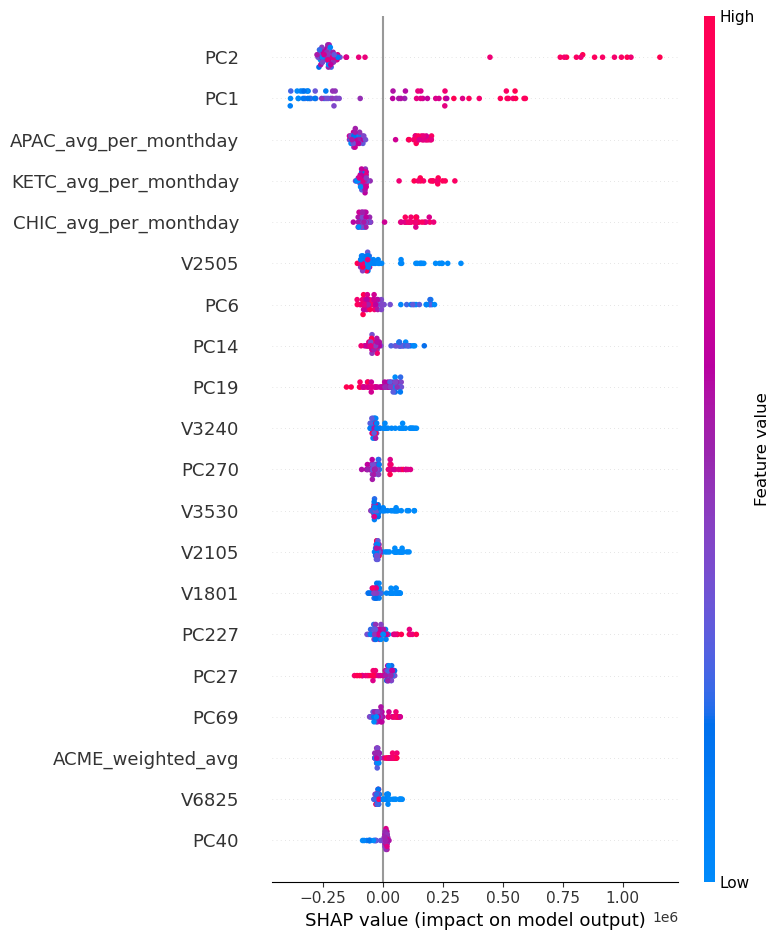

In [90]:
import shap

# Explaining model predictions using SHAP
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Plot the summary plot
shap.summary_plot(shap_values, X_train)


In [128]:
import pandas as pd
import numpy as np
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Assuming df is your DataFrame and 'ACME' is the target variable
X = df_merged.filter(like='V')  # Select all V columns
y = df_merged['ACME']

# Function to create binary variables and interactions for each "V" column
def create_interaction_terms(df_merged, quantile_threshold=0.9):
    new_df_merged = df_merged.copy()

    for col in df_merged.columns:
        # Create binary variable where the column value exceeds the 90th percentile (or chosen threshold)
        new_df_merged[col + '_high'] = (df_merged[col] > df_merged[col].quantile(quantile_threshold)).astype(int)

        # Create interaction terms with other variables (pairwise)
        for other_col in df_merged.columns:
            if col != other_col:
                new_df_merged[col + '_' + other_col + '_interaction'] = df_merged[col] * df_merged[other_col]

    return new_df_merged

# Create interaction terms for all V columns
X_interactions = create_interaction_terms(X)

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X_interactions, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor()
model.fit(X_train, y_train)

# Get feature importances
feature_importances = pd.Series(model.feature_importances_, index=X_interactions.columns).sort_values(ascending=False)

# Filter important features (above a certain threshold, e.g., 0.01)
important_features = feature_importances[feature_importances > 0.01]
print("Important features:")
print(important_features)

C:\Users\ruben\AppData\Local\Temp\ipykernel_12016\2445855631.py:21: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_df_merged[col + '_' + other_col + '_interaction'] = df_merged[col] * df_merged[other_col]
C:\Users\ruben\AppData\Local\Temp\ipykernel_12016\2445855631.py:21: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_df_merged[col + '_' + other_col + '_interaction'] = df_merged[col] * df_merged[other_col]
C:\Users\ruben\AppData\Local\Temp\ipykernel_12016\2445855631.py:21: PerformanceWarning: DataFrame is highly fragmented

Important features:
V1800_V6265_interaction            0.098694
V649_V2520_interaction             0.097073
V2074_V2520_nonzero_interaction    0.050555
V1800_V649_nonzero_interaction     0.025644
V5401_V7834_interaction            0.021877
V649_V7145_nonzero_interaction     0.013724
dtype: float32


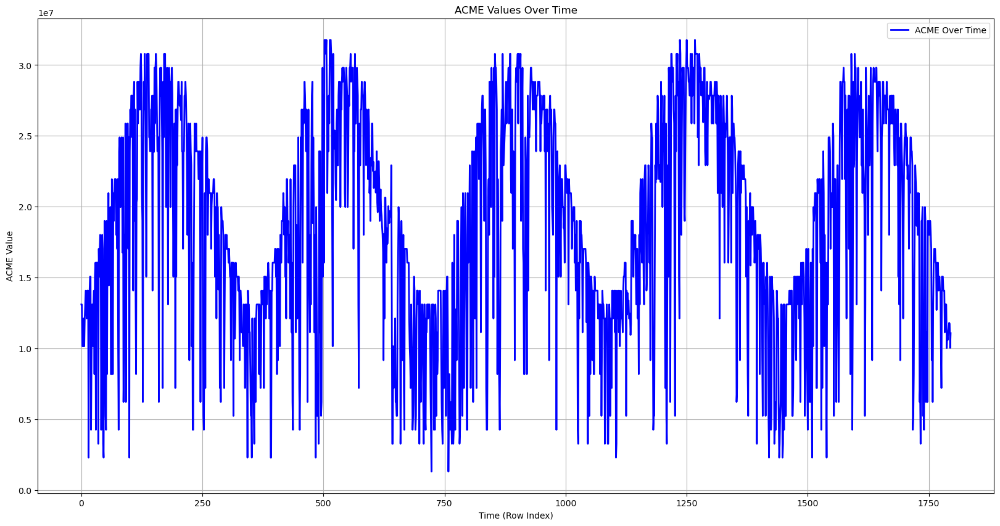

In [55]:
time_index = range(len(df_merged[5113:]))

# Plot the ACME column against the time index
plt.figure(figsize=(20, 10))
plt.plot(time_index, df_merged[5113:]['ACME'], label='ACME Over Time', color='blue', linewidth=2)

# Add labels and title
plt.xlabel('Time (Row Index)')
plt.ylabel('ACME Value')
plt.title('ACME Values Over Time')
plt.grid(True)
plt.legend()

# Show the plot
plt.show()

reference mean and std: 18071477.34332999 7714109.063450673
6909
6909


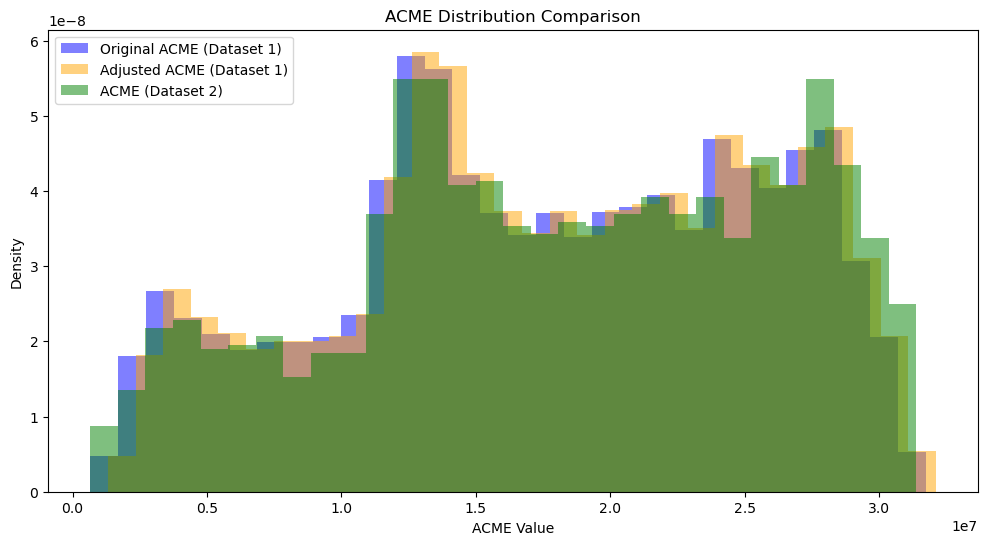

In [48]:
df_merged_mini = df_merged[5113:]  # temp to delete


# Function to remove outliers based on Z-score
def remove_outliers(df, column, reference_mean, reference_std, threshold=3):
    z_scores = np.abs((df[column] - reference_mean) / reference_std)
    df = df[z_scores < threshold]
    return df

# Function to match mean and variance
def match_mean_variance(df, column, reference_mean, reference_std):
    df_mean = df[column].mean()
    df_std = df[column].std()

    # Scale to match the mean and std of the second dataset
    df[column] = (df[column] - df_mean) / df_std * reference_std + reference_mean
    return df

# Extract ACME column from both datasets
acme1 = df_merged['ACME']
acme2 = df_merged_mini['ACME']

# Calculate reference mean and std for the second dataset
reference_mean = acme2.mean()
reference_std = acme2.std()
print("reference mean and std:", reference_mean, reference_std)

# Step 1: Remove outliers from the first dataset
df_merged_cleaned = remove_outliers(df_merged, 'ACME', reference_mean, reference_std)

# Step 2: Adjust the mean and variance of the cleaned first dataset
df1_adjusted = match_mean_variance(df_merged_cleaned.copy(), 'ACME', reference_mean, reference_std)

# Step 3: Plotting the distributions for comparison
plt.figure(figsize=(12, 6))
plt.hist(acme1, bins=30, alpha=0.5, label='Original ACME (Dataset 1)', density=True, color='blue')
plt.hist(df1_adjusted['ACME'], bins=30, alpha=0.5, label='Adjusted ACME (Dataset 1)', density=True, color='orange')
plt.hist(acme2, bins=30, alpha=0.5, label='ACME (Dataset 2)', density=True, color='green')
plt.title('ACME Distribution Comparison')
plt.xlabel('ACME Value')
plt.ylabel('Density')
plt.legend()
plt.show()

In [49]:
"""
# List of columns to exclude
exclude_columns = ["PC1", "PC2", "PC7", "PC5", "PC3", "PC10", "PC22", "PC44", "PC4", "PC11", "PC106", "PC16", "PC8"]

# Filter columns that start with "PC" but are not in the exclude_columns list
pc_columns_to_multiply = [col for col in df_merged.columns if col.startswith("PC") and col not in exclude_columns]
# Multiply the selected columns row-wise and save the result in a new column
df_merged['PC_multiplied'] = df_merged[pc_columns_to_multiply].prod(axis=1)
print(df_merged['PC_multiplied'])
"""
# indexi = 5113 - 157
# df_merged_mini = df1_adjusted[indexi:]  # temp to delete
df_merged = df1_adjusted
df_merged["PC_multiplied1"] = df_merged["PC6"] * df_merged["PC9"]
df_merged["PC_multiplied2"] = df_merged["PC12"] * df_merged["PC13"]
df_merged["PC_multiplied3"] = df_merged["PC14"] * df_merged["PC15"]

print(len(df_merged))

correlation_matrix = df_merged.corr()

acme_correlation = correlation_matrix["ACME"].drop("ACME").drop("CHIC").drop("NINN").drop("KETC").drop("APAC")

acme_correlation = acme_correlation.abs()
# Sort the correlation values
acme_correlation_sorted = pd.DataFrame(acme_correlation.filter(like="PC_").sort_values(ascending=False))
print(acme_correlation_sorted)
# print(acme_correlation_sorted.loc["PC_multiplied"])

6909
                    ACME
PC_multiplied2  0.161106
PC_multiplied3  0.086737
PC_multiplied1  0.083711


## Standardization of Data

In [223]:
def standardize_data_v(df):
    scaler = StandardScaler()
    df_scaled = df.copy()
    # Select numerical columns
    
    df_scaled = df_scaled ** 3
    df_scaled = scaler.fit_transform(df)
    return df_scaled

def standardize_data(df):
    scaler = StandardScaler()
    df_scaled = df.copy()
    # Select numerical columns
    df_scaled = df_scaled.drop(columns=["ACME", "NINN", "CHIC", "APAC", "KETC", "month_2", "month_3", "month_4", "month_5", "month_6", "month_7", "month_8", "month_9", "month_10", "month_11", "month_12", "NINN_avg_per_monthday", "CHIC_avg_per_monthday", "APAC_avg_per_monthday", "KETC_avg_per_monthday", "ACME_weighted_avg", "ACME_avg_per_monthday"], axis=1)
    df_scaled = scaler.fit_transform(df)
    return pd.concat([pd.DataFrame(df_scaled), df[["ACME", "NINN", "CHIC", "APAC", "KETC", "month_2", "month_3", "month_4", "month_5", "month_6", "month_7", "month_8", "month_9", "month_10", "month_11", "month_12", "NINN_avg_per_monthday", "CHIC_avg_per_monthday", "APAC_avg_per_monthday", "KETC_avg_per_monthday", "ACME_weighted_avg", "ACME_avg_per_monthday"]]], axis=1)


def remove_highest_percent(df, n):
    """
    Remove the n% highest observations from the DataFrame for each numeric column.

    Parameters:
    - df: DataFrame to clean
    - n: Percentage of the highest observations to remove (between 0 and 100)

    Returns:
    - DataFrame after removing the highest n% observations
    """
    # Select only numeric columns
    numeric_df = df.select_dtypes(include=['float', 'int'])
    
    # Calculate the threshold for the highest n% observations
    thresholds = numeric_df.quantile(1 - n / 100.0)
    
    # Remove the highest n% observations
    df_cleaned = df[(numeric_df <= thresholds).all(axis=1)]
    
    return df_cleaned


## PCA (Principal Component Analysis)

In [50]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

def standardize_data_v(df):
    scaler = StandardScaler()
    df_scaled = df.copy()
    # Scale the DataFrame
    df_scaled = df_scaled + 1
    df_scaled = df_scaled ** 3
    # df_scaled = scaler.fit_transform(df_scaled)
    return pd.DataFrame(df_scaled, columns=df.columns)

def standardize_data(df):
    scaler = StandardScaler()
    df_scaled = df.copy()
    
    # Drop specified columns from the copy
    columns_to_drop = ["ACME", "NINN", "CHIC", "APAC", "KETC"] + \
                      [f"month_{i}" for i in range(2, 13)]
    
    # Scale the remaining data
    df_scaled = df_scaled.drop(columns=columns_to_drop, axis=1)
    df_scaled = scaler.fit_transform(df_scaled)
    
    # Create a DataFrame and concatenate original columns back
    df_scaled = pd.DataFrame(df_scaled, columns=df.columns.difference(columns_to_drop))
    return df  # pd.concat([df_scaled, df[columns_to_drop]], axis=1)

def remove_highest_percent(df, n):
    """
    Remove the n% highest observations from the DataFrame for each numeric column.

    Parameters:
    - df: DataFrame to clean
    - n: Percentage of the highest observations to remove (between 0 and 100)

    Returns:
    - DataFrame after removing the highest n% observations
    """
    numeric_df = df.select_dtypes(include=['float64', 'int64'])  # Use correct types
    thresholds = numeric_df.quantile(1 - n / 100.0)
    df_cleaned = df[(numeric_df <= thresholds).all(axis=1)]
    return df_cleaned

def perform_pca(X, n_components, prefix='VPC'):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X)
    
    # Create a DataFrame from the PCA results
    pca_df = pd.DataFrame(X_pca)

    # Rename columns
    pca_df.columns = [f'{prefix}{i+1}' for i in range(pca_df.shape[1])]
    
    return pca_df

# Example usage:
# Remove outliers from columns starting with 'V'
# df_inliers_v = remove_highest_percent(df_merged.filter(like='V'), 1)

# Perform PCA on the scaled data
df_scaled_v = standardize_data_v(df_merged.filter(like='V'))  # df_inliers_v


# Combine with the main DataFrame
df_scaled = standardize_data(df_merged.drop(columns=df_merged.filter(like='V').columns, axis=1))


# List of columns to exclude
exclude_columns = [
    "PC3", "PC5", "PC106", "PC102", "PC174", "PC344", "PC288", "PC4",
    "PC280", "PC170", "PC287", "PC82", "PC41", "PC22", "PC1", "PC2", "PC7",
    "PC311", "PC327", "PC221", "PC25", "PC_multiplied1", "PC_multiplied2", "PC_multiplied3"]

# Filter columns that start with "PC" but are not in the exclude_columns list
pc_columns = [col for col in df_merged.columns if col.startswith("PC") and col not in exclude_columns]

# df_pca = perform_pca(df_scaled[pc_columns], n_components=0.5)

df_scaled_v = df_scaled_v.reset_index(drop=True)
df_scaled = df_scaled.reset_index(drop=True)
# df_pca = df_pca.reset_index(drop=True)


df_combined = pd.concat([df_scaled.drop(columns=pc_columns), df_scaled_v], axis=1)  # df_pca,

# Step 1: Drop all columns starting with "PC"
df_cleaned = df_combined

In [44]:
df_cleaned.columns

Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC7', 'PC22', 'PC25', 'PC41',
       'PC82',
       ...
       'V2073', 'V1785', 'V1817', 'V377', 'V2504', 'V6137', 'V6825', 'V2074',
       'V4697', 'V3977'],
      dtype='object', length=165)

# Feature Selection: 
## K-Best

## Elastic Net

In [24]:

from sklearn.linear_model import ElasticNetCV
from sklearn.linear_model import ElasticNet

def elastic_net_feature_selection_with_cv(X, y):
    # Create a range of alpha values and l1_ratio values
    alphas = np.logspace(-5, 5, 100)
    l1_ratios = np.linspace(0, 1, 10)  # L1 ratio from 0 (Ridge) to 1 (Lasso)

    # Create and fit ElasticNetCV
    elastic_net_cv = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
    elastic_net_cv.fit(X, y)

    # Best parameters
    best_alpha = elastic_net_cv.alpha_
    best_l1_ratio = elastic_net_cv.l1_ratio_

    # Fit the Elastic Net model with the best parameters
    elastic_net = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio)
    elastic_net.fit(X, y)

    # Get the coefficients and select features
    elastic_net_coefficients = pd.Series(elastic_net.coef_, index=X.columns)
    selected_features = elastic_net_coefficients[elastic_net_coefficients.abs() > 0.05].index.tolist()

    return selected_features


# Models for generating predictions
## Random Forest, Gradient Boosting, Neural Network Models

In [53]:
df_scaled = df_cleaned
# Here we can choose what data we train on in the creation of the model
indexi = 5113 - 157
X = df_scaled.drop(columns=["ACME", "NINN", "CHIC", "APAC", "KETC"], axis=1)  #  "ACME_weighted_avg", "ACME_avg_per_monthday", "month_2", "month_3", "month_4", "month_5", "month_6", "month_7", "month_8", "month_9", "month_10", "month_11", "month_12", "NINN_avg_per_monthday", "CHIC_avg_per_monthday", "APAC_avg_per_monthday", "KETC_avg_per_monthday"
X_train = X.iloc[:indexi]
X_test = X.iloc[indexi:]

y = df_scaled["ACME"]  # Target for nearby station
y_train = y.iloc[:indexi]
y_test = y.iloc[indexi:]

In [52]:


# Initialize the model with the best parameters
model = XGBRegressor(
    colsample_bytree=1.0,
    learning_rate=0.01,
    max_depth=6,
    n_estimators=2000,
    subsample=0.6,
    random_state=42
)

# Fit the model on the training data
model.fit(X_train, y_train)

# Make predictions on the test data
predictions = model.predict(X_test)

# Print the test MAE
print(f"Test MAE for XGBoost: {mean_absolute_error(y_test, predictions)}")


Test MAE for XGBoost: 2350137.383552316


In [276]:
submission = pd.read_csv("sampleSubmission.csv")
submission["ACME"] = pd.DataFrame(predictions / 1.014)
submission.to_csv("sampleSubmission-Copy.csv", index=False)

In [137]:
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {
    'n_estimators': [100, 500, 1000],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 6, 9],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# Set up the model
xgb = XGBRegressor(random_state=42)

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=xgb, param_grid=param_grid, scoring='neg_mean_absolute_error', cv=3, verbose=1)

# Fit the model
grid_search.fit(X_train, y_train)

# Get the best parameters and the best model
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

print(f"Best parameters: {best_params}")
print(f"Test MAE for optimized XGBoost: {mean_absolute_error(y_test, best_model.predict(X_test))}")


Fitting 3 folds for each of 243 candidates, totalling 729 fits


KeyboardInterrupt: 

In [31]:
"""

muahahahhahha


import pandas as pd
import numpy as np

df = pd.read_csv("50805788.csv")

# Assuming your dataframe is named df
# Create a new column that combines YEAR, MONTH, and DAY into a single date
df['Date'] = pd.to_datetime(df[['YEAR', 'MONTH', 'DAY']])
# Filter the data to keep only rows with dates up to November 30, 2012
end_date = pd.to_datetime('2012-11-30')
df = df[df['Date'] <= end_date]
df["ATOT"] = df["ATOT"].astype(int)
df[df["ATOT"] == -996] = np.nan
df["ATOT"] = df["ATOT"] * 1000000

# Use pivot_table to pivot STID as columns and ATOT as values
df_pivot = df.pivot_table(index='Date', columns='STID', values='ATOT')

# Reset index if needed
df_pivot.reset_index(inplace=True)


# Display the reshaped dataframe
print(df_pivot)
df_pivot.to_csv("ytest.csv", index=False)
"""

STID       Date        ACME        APAC        CHIC        KETC        NINN
0    2008-01-01  12000000.0  12000000.0  12000000.0  12000000.0  12000000.0
1    2008-01-02  12000000.0  12000000.0  12000000.0  12000000.0  12000000.0
2    2008-01-03   9000000.0   9000000.0   9000000.0   7000000.0   9000000.0
3    2008-01-04   9000000.0   8000000.0   9000000.0   8000000.0   8000000.0
4    2008-01-05   9000000.0   9000000.0   9000000.0  11000000.0   9000000.0
...         ...         ...         ...         ...         ...         ...
1791 2012-11-26         NaN  12000000.0  10000000.0  11000000.0  10000000.0
1792 2012-11-27         NaN  13000000.0  13000000.0  14000000.0  13000000.0
1793 2012-11-28         NaN  13000000.0  12000000.0  13000000.0  13000000.0
1794 2012-11-29         NaN  12000000.0  12000000.0  13000000.0  12000000.0
1795 2012-11-30         NaN  11000000.0  12000000.0  12000000.0  12000000.0

[1796 rows x 6 columns]


In [37]:
from sklearn.metrics import mean_absolute_error
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor

# Read the submission file
submission = pd.DataFrame()

# Hardcoded distances to ACME for each station (from the image)
distances_to_acme = {
    "NINN": 0.17460028923229295,
    "CHIC": 0.24904759585267908,
    "APAC": 0.2889927518122142,
    "KETC": 0.38062267365463004
}

# Calculate weights as inverse of distances
weights = {station: 1/distance for station, distance in distances_to_acme.items()}

# Normalize the weights so they sum to 1
total_weight = sum(weights.values())
weights = {station: weight/total_weight for station, weight in weights.items()}

# Create DataFrame to store predictions
predictions_weighted_avg = pd.DataFrame()

X = df_scaled.drop(columns=["ACME", "NINN", "CHIC", "APAC", "KETC"], axis=1)  # Features
X_train = X.iloc[:5113]
X_test = X.iloc[5113:]

# Loop over stations (excluding ACME) to train models and get predictions
for station in distances_to_acme.keys():

    y = df_scaled[station]  # Target for nearby station

    y_train = y.iloc[:5113]
    y_test = y.iloc[5113:]

    # Train the model
    model = GradientBoostingRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    
    # Predict for test data
    predictions = model.predict(X_test)
    predictions_weighted_avg[station] = predictions

# Compute the weighted average of predictions for ACME
submission['ACME_weighted_avg'] = sum(predictions_weighted_avg[station] * weight for station, weight in weights.items())

# Directly predict ACME
y_acme = df_scaled['ACME']
y_train_acme = y_acme.iloc[:5113]
y_test_acme = y_acme.iloc[5113:]

# Train the model for ACME
model_acme = GradientBoostingRegressor(n_estimators=100, random_state=42)
model_acme.fit(X_train, y_train_acme)

# Predict directly for ACME
submission['ACME_direct'] = model_acme.predict(X_test)

# Calculate MAE for both models
mae_weighted_avg = mean_absolute_error(y_test_acme, submission['ACME_weighted_avg'])
mae_direct_acme = mean_absolute_error(y_test_acme, submission['ACME_direct'])

# Print MAE comparison
print(f"MAE for weighted average model: {mae_weighted_avg}")
print(f"MAE for direct ACME model: {mae_direct_acme}")

MAE for weighted average model: 2488970.568350679
MAE for direct ACME model: 2452060.9440310556
